The data was sourced from https://geodacenter.github.io/data-and-lab/KingCounty-HouseSales2015/ 

Variable	Description

id	        Identification
date	    Date sold
price	    Sale price
bedrooms	Number of bedrooms
bathrooms	Number of bathrooms
sqft_liv	Size of living area in square feet
sqft_lot	Size of the lot in square feet
floors	    Number of floors
waterfront	‘1’ if the property has a waterfront, ‘0’ if not.
view	    An index from 0 to 4 of how good the view of the property was
condition	Condition of the house, ranked from 1 to 5
grade	    Classification by construction quality which refers to the types of materials used and the quality of workmanship. Buildings of better quality     (higher grade) cost more to build per unit of measure and command higher value. Additional information in: KingCounty
sqft_above	Square feet above ground
sqft_basmt	Square feet below ground
yr_built	Year built
yr_renov	Year renovated. ‘0’ if never renovated
zipcode	    5 digit zip code
lat	        Latitude
long	    Longitude
squft_liv15	Average size of interior housing living space for the closest 15 houses, in square feet
squft_lot15	Average size of land lots for the closest 15 houses, in square feet
Shape_leng	Polygon length in meters
Shape_Area	Polygon area in meters

Client: Erin Robinson 
She invests in poor neighborhoods, he is buying & selling. She wants to break even and gain small surplus on his investment.
She tries to act socially responsible

Assumption: 

Poor neighborhood comprise of low price houses, old etc.

 1: Are houses with little to no renovation activity more likely to be in poor neighborhoods?

 2: Are historical houses more likely to be in poor neighborhoods?
 
 3.is there a correlation between the number of rooms and the neighborhood quality?

 4.is there a geospatial gradient regarding the neighborhood quality? E.g. do rich neighborhoods ly far away from poor neighborhoods or 
  does the quality of the neighborhood change abruptly?
 
        

 5.Are revovation activities happen to take place within a certain time frame and spatial area?
 
        Hypothesis: Renovation activities happen to take place within a certain time frame and spatial area and are a clear indicator for gentrification.

        Hypothesis: proximity to amenities like schools, parks, or shopping increase property values. 

        Hypothesis: Crime rates:  neighborhoods with lower crime rates are more favorable for buyers. Cross-referencing  dataset with local crime statistics required



In [1]:
import warnings

warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import plotly.express as px
import folium


from matplotlib.ticker import PercentFormatter
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()

pd.set_option('display.float_format', lambda x: '%.3f' % x)

pd.set_option('display.max_columns', None)

In [2]:
#import the data from a csv-file
df = pd.read_csv('./eda.csv')

# check the first 5 columns of the dataframe
df.iloc[:, 0:5]

#* check if the house_id and id.1 are the same and make sure that only True is returned
(df.house_id == df['id.1']).value_counts()

#since the house_id and id.1 are the same, we can drop the id.1 column
df.drop(columns='id.1', inplace=True)



In [5]:
# we convert the date column to datetime
df['date'] = pd.to_datetime(df['date'])

In yet another dataframe we read the median income data for King County. Source: U.S. Census Bureau release, the 2021 American Community Survey

In [3]:
import openpyxl # needed to read excel files
df_income = pd.read_excel("Median Income King County.xlsx")

# we clean the data
df_income.columns = df_income.columns.str.strip().str.lower().str.replace(' ', '_')
df_income.median_income = df_income.median_income.str.strip().str.replace("$","").str.replace(',', '').astype(float)
df_income.average_income = df_income.average_income.str.strip().str.replace("$","").str.replace(',', '').astype(float)

df_income.median_income = df_income.median_income.astype(int)
df_income.average_income = df_income.average_income.astype(int)

df_income.population = (df_income.population * 1000).astype(int)
df_income.number_of_households = (df_income.number_of_households * 1000).astype(int)

# we drop the rows with median income 0
df_income = df_income[df_income.median_income != 0]   




In [4]:
# we check the data types of the columns and memory usage for the initial dataframe
df.info(memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           21597 non-null  object 
 1   price          21597 non-null  float64
 2   house_id       21597 non-null  int64  
 3   id             21597 non-null  int64  
 4   bedrooms       21597 non-null  float64
 5   bathrooms      21597 non-null  float64
 6   sqft_living    21597 non-null  float64
 7   sqft_lot       21597 non-null  float64
 8   floors         21597 non-null  float64
 9   waterfront     19206 non-null  float64
 10  view           21534 non-null  float64
 11  condition      21597 non-null  int64  
 12  grade          21597 non-null  int64  
 13  sqft_above     21597 non-null  float64
 14  sqft_basement  21145 non-null  float64
 15  yr_built       21597 non-null  int64  
 16  yr_renovated   17749 non-null  float64
 17  zipcode        21597 non-null  int64  
 18  lat   

Our DataFrame is using 4.8 MB random access memory RAM (more or less, I recommend reading up the memory_usage argument on pythonspeed.com). Not a big deal but out dataframe is quite small. If we have to handel BIGDATA it might be advisable to find ways to reduce teh memory usage. Beeing a layman and RAM getting ever cheaper, I still would say that it is good practice to utilize efficient datatypes.
So that´s what we are going to do:

In [6]:
'''we convert the yr_built and yr_renovated columns to int16 to save memory. We do not replace the 0 with nan values in the yr_renovated column 
because we want to keep the type of the column as int16. We could convert the yr_renovated column to string type 
and then replace the 0 with nan values, but we would lose memory. '''

df.yr_built = df.yr_built.astype("int16")
df.yr_renovated = df.yr_renovated.fillna(0)
df.yr_renovated = (df.yr_renovated / 10).astype("int16")



In [7]:
''' since we have some NaN values in the sqft_basement column, we will check the sqft_living column against the sqft_above column to see if we
can impute the NaN values with the difference of the two columns'''

df.loc[df.sqft_basement.isna(), ["sqft_living", "sqft_above", "sqft_basement"]]

'''we can see that in many cases the values for sqft_above is much smaller than the sqft_living values.
Therfore imputing NaN values in the sqft_basement column with the difference between the sqft_living and sqft_above columns makes sense'''

df.sqft_basement = df.sqft_basement.fillna(df.sqft_living - df.sqft_above).astype("int16")
df.sqft_basement.isna().sum()

0

In [8]:
'''in the waterfront column we have 2 values, 0 and 1. We convert the column to category type to save memory.
in a small dataset like this it does not make a difference, but in a large dataset it does, so we do it as good practice.'''
df.waterfront = df.waterfront.astype("category")
df.waterfront.value_counts()

# the same reason as above, we convert the view, condition, zipcode and grade column to category type.
df.view = df.view.astype("category")
df.condition = df.condition.astype("category")
df.grade = df.grade.astype("category")
df.zipcode = df.zipcode.astype("category")


# Floors, Bedrooms and bathrooms column we convert to int8 type, again to save memory.
df.bedrooms = df.bedrooms.astype("int8")
df.bathrooms = df.bathrooms.astype("int8")
df.floors = df.floors.astype("int8")

# we convert the price column to int32 type, because we do not need the precision of float64 type.
df.price = df.price.astype("int32")

# we convert the sqft_living, sqft_lot, sqft_above, sqft_basement, sqft_living15, sqft_lot15 columns to squaremeters and int16 type.
conversion_factor = 0.092903
columns_to_convert = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15']
df[columns_to_convert] = df[columns_to_convert].apply(lambda x: (x * conversion_factor).astype("int16"))

# we rename the columns appropriately
df.rename(columns = {"sqft_living": "sqm_living", "sqft_lot": "sqm_lot", "sqft_above": "sqm_above", "sqft_basement": "sqm_basement", "sqft_living15": "sqm_living15", "sqft_lot15": "sqm_lot15"}, inplace=True)

# we check the memory usage again to see how much memory we saved.
df.info(memory_usage="deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 22 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   date          21597 non-null  datetime64[ns]
 1   price         21597 non-null  int32         
 2   house_id      21597 non-null  int64         
 3   id            21597 non-null  int64         
 4   bedrooms      21597 non-null  int8          
 5   bathrooms     21597 non-null  int8          
 6   sqm_living    21597 non-null  int16         
 7   sqm_lot       21597 non-null  int16         
 8   floors        21597 non-null  int8          
 9   waterfront    19206 non-null  category      
 10  view          21534 non-null  category      
 11  condition     21597 non-null  category      
 12  grade         21597 non-null  category      
 13  sqm_above     21597 non-null  int16         
 14  sqm_basement  21597 non-null  int16         
 15  yr_built      21597 non-null  int16 

Such WOW! We reduced the memory usage by almost 75 %.

In [ ]:
df.yr_renovated.value_counts()

In [9]:

# next we check for duplicates in the dataframe house_id column
df.house_id.duplicated().value_counts() # 177 duplicates found

# we investigate the duplicates
df[df.house_id.duplicated(keep = False)].sort_values (by = 'house_id')

# now we want to check in which columns the duplicates might be different
duplicated = df[df.house_id.duplicated(keep = False)].sort_values (by = 'house_id').iloc[:, 0:5]
'''we find differences between the duplicates in the following columns:
- date: here we find that the duplicates are from different years
- price the houses seem to have different prices on different dates
'''
duplicated

df[['lat', 'long']].duplicated().value_counts() # we found 779 duplicates for the latitute and longitude combinations



False    20818
True       779
dtype: int64

we want to have grasp of the the few outliers in the price column. We check the 10 highest prices and plot them on a map to see where they are located.


In [11]:
highest_10 = df.sort_values(by = "price", ascending = False).head(20)

# we plot the 10 highest prices on a map
fig = px.scatter_mapbox(highest_10, lat="lat", lon="long", color="price", size="price",
                        hover_name="price", hover_data=["sqm_living", "sqm_lot","yr_built", "yr_renovated", "view", "condition", "grade", "zipcode"],
                    color_continuous_scale=px.colors.sequential.amp, size_max=15, zoom=10,
                    mapbox_style="stamen-terrain")
fig.show()


In [10]:
# we check the distribution of the price column
df.price.describe()
# 95th percentile
print(df.price.quantile(0.95), df.shape)


1160000.0 (21597, 22)


0.6274122220642481



We will remove the top 5% of the prices from the dataframe


We discard all houses with price tags above the 95th percentile we thus treat the houses with a price higher than 1,1 million as not relevant for our analysis, since our client is interested in affordable living costs per squaremeter.

In [ ]:

dflow = df[df.price < df.price.quantile(0.95)]

# we check the correlation between the price and sqm_living columns
dflow['price'].corr(df.sqm_living)


We test the correlation between the price and the living space

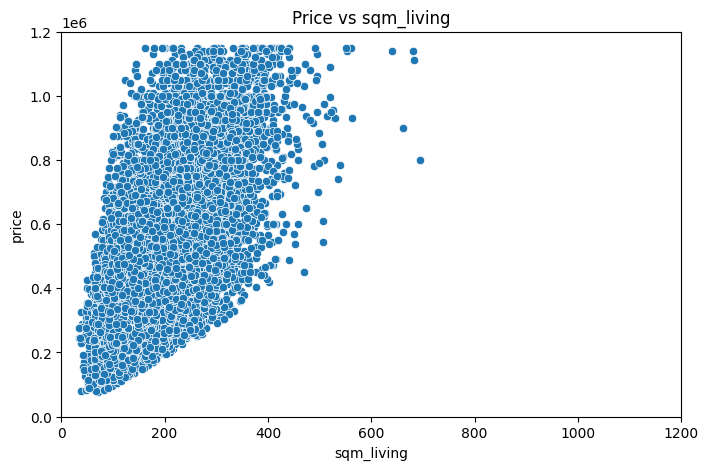

In [12]:
# we check the correlation between the price and the sqm_living columns
dflow.price.corr(dflow.sqm_living)

# we plot the price against the sqm_living column
sns.scatterplot(x = dflow.sqm_living, y = dflow.price)
plt.title("Price vs sqm_living")
plt.xlim(0, 1200)
plt.ylim(0, 1200000)
plt.xlabel("sqm_living")
plt.ylabel("price")
plt.show()
# we can see that there is a fairly strong positive correlation between the price and the sqm_living columns



we create a new column with the ratio of price and sqm_living

In [13]:
dflow["price_sqml"] = dflow.price / dflow.sqm_living
dflow.price_sqml.describe()

count   20513.000
mean     2750.149
std      1086.200
min       944.853
25%      1935.349
50%      2575.107
75%      3306.452
max      8749.500
Name: price_sqml, dtype: float64

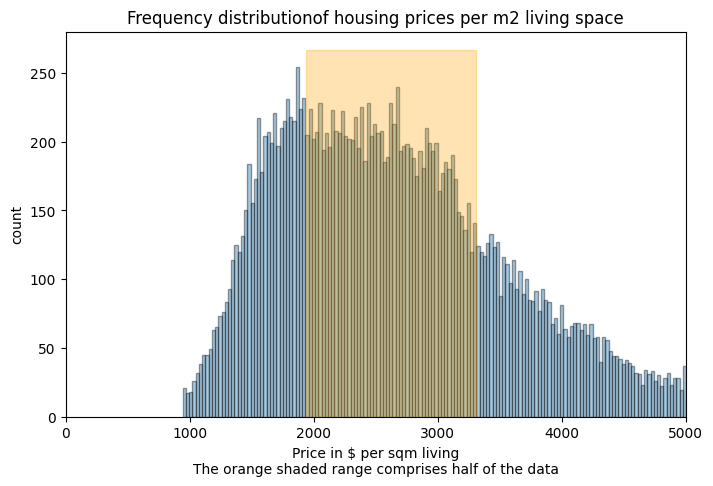

In [14]:
# we plot the distribution of the price_sqml column. We limit the x-axis to 5000.

sns.distplot(dflow.price_sqml, kde=False, bins=300, hist_kws=dict(edgecolor="k", linewidth=1), norm_hist=False)
plt.xlim(0, 5000)
# Get the quartiles
q1 = dflow.price_sqml.quantile(0.25)
q3 = dflow.price_sqml.quantile(0.75)

# Shade the interquartile range
plt.fill_between([q1, q3], 0, plt.gca().get_ylim()[1], color='orange', alpha=0.3)
plt.title("Frequency distributionof housing prices per m2 living space")
plt.xlabel("Price in $ per sqm living\nThe orange shaded range comprises half of the data")
plt.ylabel("count")
plt.show()

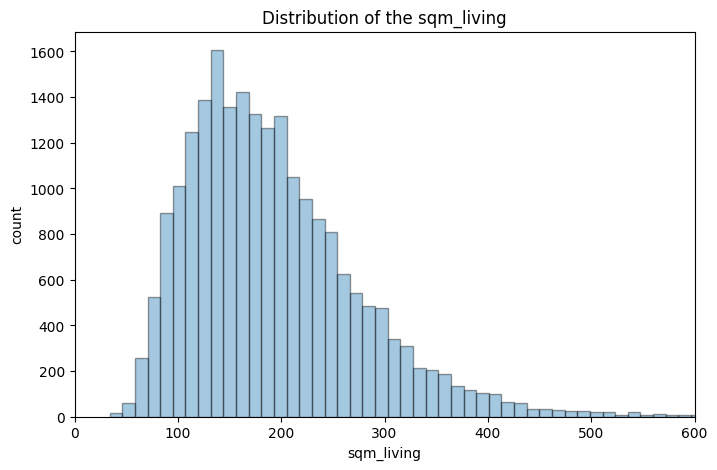

In [15]:
# we check the distribution of the sqm_living column
df.sqm_living.describe()

# we plot the distribution of the sqm_living column
sns.distplot(df.sqm_living, kde=False, bins=100, hist_kws=dict(edgecolor="k", linewidth=1))
plt.xlim(0, 600)
plt.title("Distribution of the sqm_living")
plt.xlabel("sqm_living")
plt.ylabel("count")
plt.show()



In [16]:
#we create a geodataframe from the dataframe and save it as a geopackage

gdflow = gpd.GeoDataFrame(dflow, geometry=gpd.points_from_xy(dflow.long, dflow.lat), crs="EPSG:4326")



## Condition of a real-estate
In the context of real estate, the "condition" of a house generally refers to the state of the house in terms of its age, wear and tear, upkeep, and overall maintenance. Unlike "grade," which typically refers to the quality of construction, "condition" refers to the current state of the property, which can change over time and can be improved with repairs and renovations.

Typically, condition is rated on a scale, with a higher number indicating better condition. Here's a general guideline:

Poor (1): Significant defects, damages, or functional issues. The house may not be habitable in its current condition and may require extensive repairs or renovations.
Fair (2): Some defects or issues are present. The house is habitable but may need repairs or updates.
Average (3): The house shows normal wear and tear for its age. Some minor repairs or updates may be needed, but the house is generally in acceptable condition.
Good (4): The house is in good condition, with only minor visible issues if any. It has likely been well-maintained or recently updated.
Excellent (5): The house is in excellent condition, with no visible issues. It has likely been meticulously maintained or recently renovated.
Again, the specifics of what each condition rating represents can vary depending on the specific rating system used. You should check the documentation of your dataset or contact the data provider for a precise definition of what each condition rating in your dataset represents.

## Grade of a real-estate
In the context of real estate, a "grade" typically refers to the level of construction quality of improvements in a property. These grades are generally given by a rating system used by local appraisal authorities and can significantly influence the value of a property.

Here's a general guideline of what different grades might represent:

Low-Grade (1-3): These homes have poor construction and design quality, and might not comply with local building codes. They are generally very simple and economical in terms of design and functionality.
Average-Grade (4-7): These homes are built to a standard that is generally accepted for the average homeowner. They have a decent level of design quality and are functional for most families.
High-Grade (8-10): These homes are professionally designed with high-quality materials and workmanship. They often feature custom architecture and luxury finishes.
Very High-Grade (11-13): These homes are typically custom-designed by an architect, with top-quality materials, finishes, and specialized craftsmanship. They often include luxurious amenities and can be considered "top of the line" in terms of quality and price.
Please note that the specifics of what each grade represents can vary depending on the specific grading system used, and the range you provided (3-13) suggests that your dataset might be using a slightly different system. You should check the documentation of your dataset or contact the data provider for a precise definition of what each grade in your dataset represents.

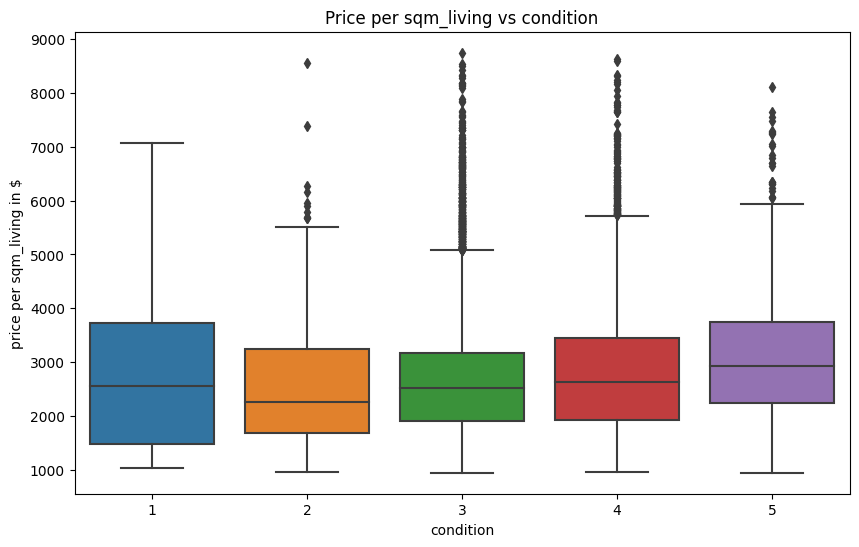

In [18]:
#we want to see the the distribution between the price_sqml column and the condition of the house. We use boxplots for this.
fig, ax = plt.subplots(figsize=(10, 6))
sns.boxplot(x = "condition", y = "price_sqml", data = dflow, ax=ax)
plt.title("Price per sqm_living vs condition")
plt.xlabel("condition")
plt.ylabel("price per sqm_living in $")
plt.show()





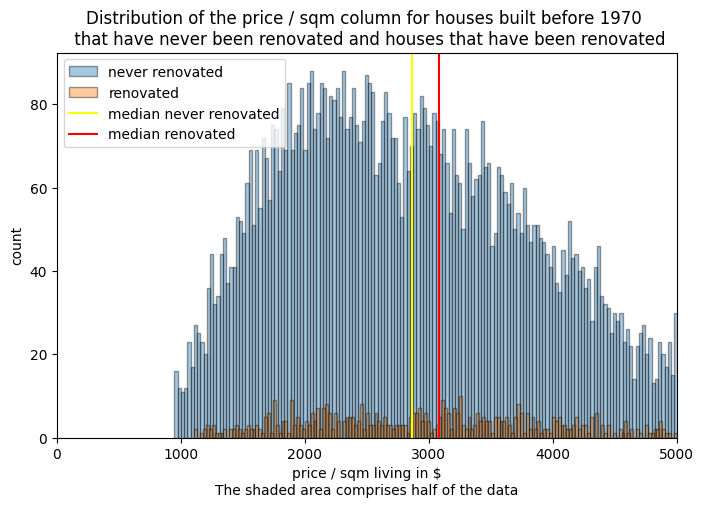

In [19]:
# now let´s see into the distribution of the price_sqml column along the houses that have never been renovated and the houses that have been renovated
# we filter the dataframe for houses that have never been renovated and are older than 1970
never_renovated = dflow[(dflow.yr_renovated == 0) & (dflow.yr_built < 1970)]

# we filter the dataframe for houses that have been renovated and are older than 1970
renovated = dflow[(dflow.yr_renovated != 0) & (dflow.yr_built < 1970)]

# we plot the distribution of the price_sqml column for the houses that have never been renovated and the houses that have been renovated
sns.distplot(never_renovated.price_sqml, kde=False, bins=300, hist_kws=dict(edgecolor="k", linewidth=1), norm_hist=False, label = "never renovated")
sns.distplot(renovated.price_sqml, kde=False, bins=300, hist_kws=dict(edgecolor="k", linewidth=1), norm_hist=False, label = "renovated")

# We plot the median for never_renovated and plot it as vetical line
median = never_renovated.price_sqml.median()
plt.axvline(median, 0, 1, color='yellow', label='median never renovated')

#same for renovated
median = renovated.price_sqml.median()
plt.axvline(median, 0, 1, color='red', label='median renovated')


plt.xlim(0, 5000)

plt.legend(loc='upper left')
plt.title("Distribution of the price / sqm column for houses built before 1970 \n that have never been renovated and houses that have been renovated")
plt.xlabel("price / sqm living in $\nThe shaded area comprises half of the data")
plt.ylabel("count")
plt.show()



we see that the majority of unrenovated houses that are built prior to 1970 have a price per sqm_living of less than 2800 $. 

In [20]:
#Next we load the shapes of the King County zipcodes into a geodataframe
# we read the shapes of the zipcodes into a geodataframe
gdfzip = gpd.read_file("CK_ZIP.geojson", driver='GeoJSON')

In [22]:
#we check the median income for the zipcodes from the df_income dataframe
df_income.median_income.describe()




count       81.000
mean    114139.543
std      38490.709
min      59742.000
25%      87418.000
50%     107109.000
75%     138401.000
max     250001.000
Name: median_income, dtype: float64

We merge the df2 dataframe with the gdf_income geodataframe, in order to create a chloropleth map of the median income in the area


In [23]:
gdf3 = gdfzip.merge(df_income, left_on = "ZIP", right_on = "zipcode")

We create a chloropleth map of the median income in the area, we set the x min to 50000 and the x max to 120000
You might need to play with min and max value to see what works best in terms of colorgrading


In [24]:
fig = px.choropleth_mapbox(gdf3, geojson=gdf3.geometry, locations=gdf3.index, color="median_income",
                            color_continuous_scale="amp",
                            range_color=(50000, 120000),
                            mapbox_style="stamen-terrain", zoom=10, center = {"lat": 47.5112, "lon": -122.257}, # mapbox_style- argument gives us this neat real data background map 
                            opacity=0.65,
                            labels={'median_income':'Median Income $'},
                            hover_name = "ZIP",
                            hover_data = ["population", "number_of_households", "average_income",], # hover over the zipcodes to see what the argument does.
                            width=1000, height=800)
                            
fig 
                            

In [26]:
# now that we have a geographical display of the median income in the area, we want to see if 
# there is a correlation between the median income and the price of the houses in the area

# we merge the gdflow dataframe with the df_income dataframe
gdf4 = gdflow.merge(df_income, left_on = "zipcode", right_on = "zipcode")


In [29]:
# we create a scatter plot of the price_per_sqm_living in the area on a map
fig = px.scatter_mapbox(gdf4, lat='lat', lon='long',

                        color='price_sqml',
                        
                         
                        size='median_income',
                        range_color=(1000, 4000),
                        size_max=5,
                        hover_name='yr_built',
                        mapbox_style="stamen-terrain",
                        zoom=9, center = {"lat": 47.5112, "lon": -122.257},
                        title = "Houses prices per sqm in Bellevue",
                        labels={'red':'Color Label',  
                                'green':'Size Label'},
                        width=1000,
                        height=800,
                          ) 

fig.show()

We can see a sharp price gradient from the center in the north to the south and a less proncounced gradient from center to north.

North of the center we might find a lot of affordable houses among more expensive ones. This area could be interesting to focus on. 
Let´s check the median Income for the different zip codes to learn more.

The zip codes areas north of the expensive center is also higher in median income than the areas south of the center.
This could be an indicator for preferable neighbourhoods to live in, with prospect of increasing the house prices after renovations.

Investing in houses in poor income (low-median income areas) like in the south of the center could bear more risk, since lower income
allows for less money to spend on renovations. This could lead to a lower increase in house prices after renovations in said area.

Other factors to consider might be crime rates and available ameneties in an area. For time reason we have to exclude this.

now we want to combine the chloropleth map for the median income per zipcode with the map for the price_sqml per house
Since plotly.express does not support the overlay of two maps natively we have to use a workaround with the plotly.graph_objects library


In [31]:
import plotly.graph_objects as go



# Create your figure
fig = go.Figure()   #* the go.Figure() object allows us to add multiple "traces" (data visualizations) to the same figure.

# Add the choropleth layer (.add_trace)
fig.add_trace(go.Choroplethmapbox(geojson=gdf3.geometry.__geo_interface__, locations=gdf3.index, z=gdf3['median_income'],
                                  colorscale="amp", zmin=50000, zmax=120000, marker_opacity=0.7, marker_line_width=0, 
                                  text=gdf3["ZIP"], hoverinfo='text+z',
                                  colorbar=dict(title='Median Income<br>in $<br>')))

# Add the scatter layer 
fig.add_trace(go.Scattermapbox(lat=gdf4['lat'], lon=gdf4['long'], mode='markers',
                               
                               marker=go.scattermapbox.Marker(size=3, color=gdf4['price_sqml'], 
                                                              colorscale='speed', sizemode='area', sizemin=4, sizeref=0.01, 
                                                              colorbar=dict(title='$ / m2<br> ', x = -0.15), cmin=1000, cmax=4000,),
                               text=gdf4['yr_built'], hoverinfo='text'))

# Set mapbox style and center
fig.update_layout(title = "Price/sqm distribution in context <br>of median incomes for different zip codes",
                  mapbox_style="stamen-terrain", mapbox_zoom=8.5, mapbox_center = {"lat": 47.5112, "lon": -122.257}, width=1000, height=800,) #* mapbox center centers the map around a defined point. Can also be dynamically set.

# Show the figure
fig.show()



<AxesSubplot:title={'center':'Number of houses renovated per year'}, xlabel='yr_renovated'>

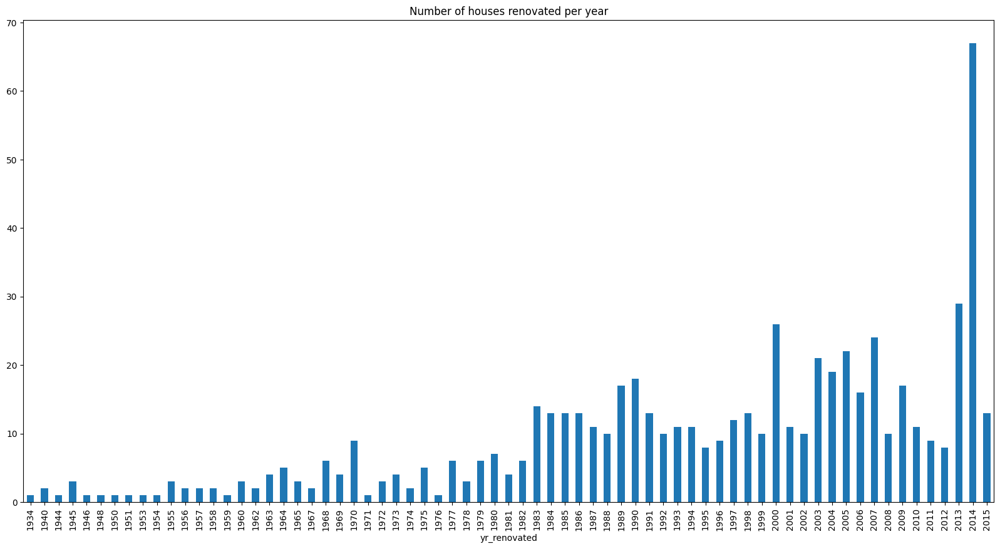

In [33]:
# we now want to test the  Hypothesis: Renovation activities happen to take place within a certain time frame and spatial area and are a clear indicator for gentrification.
# we plot the renovation year on a timeline and zipcode map

renovated = gdflow[gdflow.yr_renovated != 0]
renovated.groupby("yr_renovated").count().id.plot(kind="bar", figsize=(20,10), title="Number of houses renovated per year")

# to be continiued
